# Anotações e Entendimento Geral do Paper Pix2Pix GAN:
A arquitetura da rede Pix2Pix original proposta é um modelo de redes adversárias generativas (GANs) voltado para tarefas de tradução de imagem para imagem. Ela consiste em dois componentes principais: o Gerador (Generator) e o Discriminador (Discriminator). A ideia da rede pix2pix é aprender um mapeamento de imagens de entrada para imagens de saída, como por exemplo pegar imagens em preto e branco e colori-las, ou trancrever mapas para imagens reais, entre outros.

### Gerador:
O gerador utiliza uma arquitetura de encoder-decoder com skip connections, semelhante à U-Net.Seguindo o artigo temos:
 - Encoder: c64-c128-c256-c512-c512-c512-c512-c512
 - Decoder: cd512-cd512-cd512-c512-c256-c128-c64

### Discriminador:
O discriminador utiliza uma arquitetura chamada PatchGAN. Em vez de classificar a imagem inteira como real ou falsa, ele divide a imagem em patches menores e faz a classificação em cada um desses patches. Nessa arquitetura específica definimos tamanhos para que os patches tenham tamanho 70x70 na imagem orginal.
- Arquitetura: c64-c128-c256-c512
- Camada Final: aplica uma convolução que transforma o mapa de ativação em uma dimensão (1D), seguida por uma função sigmoid para produzir a probabilidade de autenticidade.


## Obervações importantes acerca da execução desse trabalho:
Para esse trabalho acabei fazendo duas versões, a versão local, que é este notebook e uma versão no Google Colab, que pode ser acessada aqui:
Essa versão local está mais explicada e documentada, com leves diferenças em relação à versão do Colab, pois no Colab foquei em criar uma versão apenas para tentar rodar o modelo por mais tempo.

## Desenvolvimento do Código:

### Importando bibliotecas

In [45]:
import os
import numpy as np
import tensorflow as tf

from matplotlib import pyplot as plt

from keras.optimizers import Adam
from keras.initializers import RandomNormal

from keras.models import Model
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import LeakyReLU
from keras.layers import Activation
from keras.layers import Concatenate
from keras.layers import Conv2DTranspose
from keras.layers import BatchNormalization
from keras.losses import BinaryCrossentropy
from keras.layers import ZeroPadding2D
from keras import Sequential

from tensorflow.keras.layers import Input
from tensorflow.keras.utils import plot_model


## Carregando os Dados e Criando Datasets

Inicialmente a ideia é utilizar os datasets sugeridos pelo paper, escolhi o dataset "facades" por ser um dataset mais leve e menor. A ideia será a rede receber as imagens estilo "projeto arquitetônico" e a partir dele prever a imagem realista. Se der tempo, e ter GPU sobrando, tentarei fazer o processo reverso.

In [14]:
# DEFININDO ALGUMAS VARIÁVEIS "GLOBAIS" QUE SERÃO ÚTEIS POSTERIORMENTE:

BUFFER_SIZE = 400
BATCH_SIZE = 1 # seguindo análises do paper, esse tamanho se mostrou mais eficiente
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 3
INPUT_IMG = None # imagem que usaremos para comparar diferete partes do processo
TARGET_IMG = None # imagem que usaremos para comparar diferete partes do processo


In [50]:
# Como baixar o Dataset caso necessário (no caso desse notebook ele já está baixado na pasta facades):

"""
dataset_name = "facades" #@param ["cityscapes", "edges2handbags", "edges2shoes", "facades", "maps", "night2day"]

# Caminho do diretório onde o dataset será salvo
current_dir = pathlib.Path().resolve()  # Caminho do diretório atual
destination_path = current_dir / 'datasets' / dataset_name

# Verifique se o dataset já foi baixado
if not destination_path.exists():
    _URL = f'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{dataset_name}.tar.gz'

    path_to_zip = tf.keras.utils.get_file(
        fname=f"{dataset_name}.tar.gz",
        origin=_URL,
        extract=True)

    path_to_zip = pathlib.Path(path_to_zip)
    extracted_path = path_to_zip.with_suffix('')  # tirando o .tar.gz
    PATH = extracted_path.parent / dataset_name

    destination_path.mkdir(parents=True, exist_ok=True)
    for item in PATH.iterdir():
        shutil.move(str(item), str(destination_path))

    # Remova a pasta original vazia
    PATH.rmdir()

    
    print(f"Dataset {dataset_name} salvo em {destination_path}")
else:
    print(f"Dataset {dataset_name} já existe em {destination_path}")

# Verifique o conteúdo do diretório do dataset movido
print(f"Conteúdo do dataset em {destination_path}:")
for item in destination_path.iterdir():
    print(item)
"""


'\n\ndataset_name = "facades" #@param ["cityscapes", "edges2handbags", "edges2shoes", "facades", "maps", "night2day"]\n\n# Caminho do diretório onde o dataset será salvo\ncurrent_dir = pathlib.Path().resolve()  # Caminho do diretório atual\ndestination_path = current_dir / \'datasets\' / dataset_name\n\n# Verifique se o dataset já foi baixado\nif not destination_path.exists():\n    _URL = f\'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{dataset_name}.tar.gz\'\n\n    path_to_zip = tf.keras.utils.get_file(\n        fname=f"{dataset_name}.tar.gz",\n        origin=_URL,\n        extract=True)\n\n    path_to_zip = pathlib.Path(path_to_zip)\n    extracted_path = path_to_zip.with_suffix(\'\')  # tirando o .tar.gz\n    PATH = extracted_path.parent / dataset_name\n\n    destination_path.mkdir(parents=True, exist_ok=True)\n    for item in PATH.iterdir():\n        shutil.move(str(item), str(destination_path))\n\n    # Remova a pasta original vazia\n    PATH.rmdir()\n\n    \n    print(f"Dat

In [4]:
def load(path, size=(256, 256)):
    # Ler e decodificar um arquivo de imagem para um tensor uint8
    img = tf.io.read_file(path)
    img = tf.io.decode_jpeg(img)

    # Dividir cada tensor de imgm em dois tensores:
    # - um com a imgm real da fachada do prédio
    # - um com a imgm da etiqueta da arquitetura
    w = tf.shape(img)[1]
    w = w // 2
    input_img, real_img = img[:, w:, :], img[:, :w, :]

    # Converter ambas as imgns para tensores float32
    input_img = tf.cast(input_img, tf.float32)
    real_img = tf.cast(real_img, tf.float32)

    return input_img, real_img

### Imagem que será usada em todos os exemplos posteriores:
Para manter a consistência nos dados que estamos vizualizando, escolhi essa imagem para ser a imagem de exemplo 'datasets/facades/train/37.jpg' que serão INPUT_IMG e TARGET_IMG


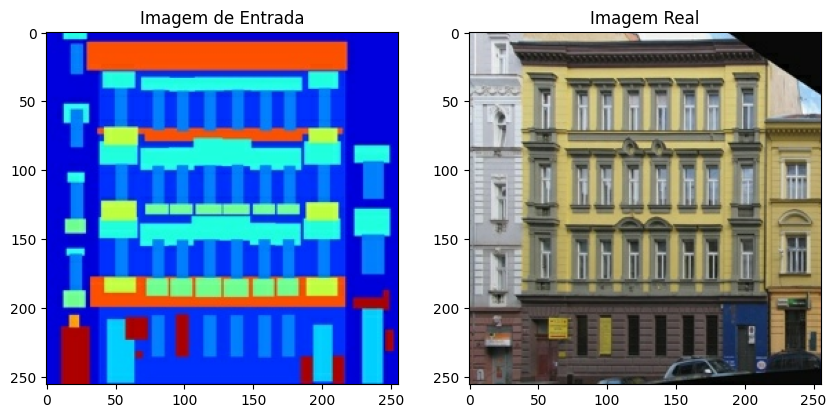

In [16]:
def plot_images(input_img, real_img):
    plt.figure(figsize=(10, 5))

    # Exibir a imgm de entrada
    plt.subplot(1, 2, 1)
    plt.title('Imagem de Entrada')
    plt.imshow(input_img / 255.0)  # Ajustar escala 

    # Exibir a imgm real
    plt.subplot(1, 2, 2)
    plt.title('Imagem Real')
    plt.imshow(real_img / 255.0)  # Ajustar escala

    plt.show()

path = 'facades/train/69.jpg'  
INPUT_IMG, TARGET_IMG = load(path)
plot_images(INPUT_IMG, TARGET_IMG)

Como descrito no artigo [pix2pix paper](https://arxiv.org/abs/1611.07004), você precisa aplicar jittering aleatório e espelhamento para preprocessar o conjunto de treinamento. Isso seria uma certa forma e ideia de data augmentation.

1. Redimensionem cada imagem 256 x 256 para uma altura e largura maiores (286 x 286).

2. Recortem aleatoriamente a imagem de volta para 256 x 256.

3. Virem aleatoriamente a imagem horizontalmente, ou seja espelhamento aleatório.
.
4. Normalizem as imagens para a faixa [-1, 1]..

Porém farei isso posteriormente, primeiro quero garantir que a rede funciona de maneira simples.
Para facilitar essa etapa de dados usei de base alguns códigos já existentes.

In [17]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [18]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [19]:
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [20]:
@tf.function()
def random_jitter(input_image, real_image):
  # Resizing to 286x286
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # Random cropping back to 256x256
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

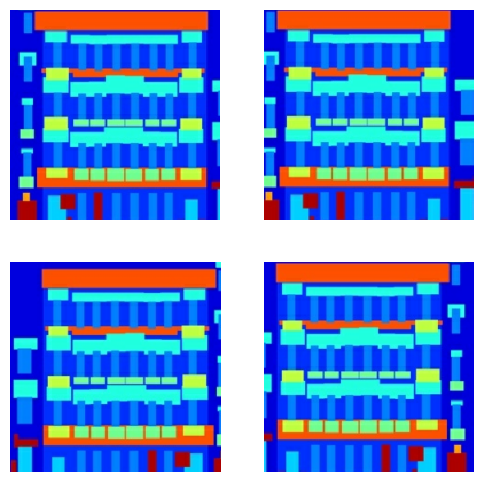

In [21]:

plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(INPUT_IMG, TARGET_IMG)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

### Definindo os Datasets e DataLoaders e como fazer o Load das imagens

In [22]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [23]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [24]:
train_dataset = tf.data.Dataset.list_files('facades/train/*.jpg')
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

try:
  test_dataset = tf.data.Dataset.list_files('facades/test/*.jpg')
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files('facades/val/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Definindo o Gerador

O gerador do pix2pix cGAN é uma U-Net modificada. Uma U-Net consiste em um codificador (downsampler) e um decodificador (upsampler), nesse caso, com skip-connections entre cada uma das partes.

 - Cada bloco no codificador é: Convolução -> Normalização em Lote (Batch normalization) -> Leaky ReLU
 - Cada bloco no decodificador é: Convolução Transposta -> Normalização em Lote -> Dropout (aplicado nos primeiros 3 blocos) -> ReLU
 - Existem skips connections entre o codificador e o decodificador.

In [43]:
def downsample(filters, size, apply_batchnorm=True):
    """
    Função que cria um bloco de downsampling (redução de amostragem) para uma rede neural convolucional.

    Parâmetros:
    filters (int): Número de filtros na camada de convolução.
    size (int): Tamanho do kernel da camada de convolução.
    apply_batchnorm (bool): Se True, aplica a normalização em lote após a camada de convolução. Padrão é True.

    Retorna:
    tf.keras.Sequential: Um bloco sequencial contendo uma camada de convolução, opcionalmente uma camada de 
                         normalização em lote, e uma camada LeakyReLU.
    """
    
    # Inicializador dos pesos da camada convolucional com distribuição normal e desvio padrão 0.02
    init = RandomNormal(stddev=0.02)
    
    # Criação de um modelo sequencial para adicionar camadas
    res = Sequential()
    
    # Adiciona uma camada de convolução 2D com os filtros, tamanho do kernel, 
    # stride de 2 e padding 'same' para manter as dimensões de saída
    res.add(Conv2D(filters, (size, size), strides=(2, 2), padding='same', kernel_initializer=init))
    
    # Se apply_batchnorm for True, adiciona uma camada de normalização em lote
    if apply_batchnorm:
        res.add(BatchNormalization())
    
    # Adiciona uma camada de ativação LeakyReLU com um coeficiente negativo de 0.2
    res.add(LeakyReLU(negative_slope=0.2))
    
    # Retorna o modelo sequencial criado
    return res

In [28]:
def upsample(filters, size, apply_dropout=False):
    """
    Função que cria um bloco de upsampling (aumento de amostragem) para uma rede neural convolucional.

    Parâmetros:
    filters (int): Número de filtros na camada de convolução transposta.
    size (int): Tamanho do kernel da camada de convolução transposta.
    apply_dropout (bool): Se True, aplica a camada Dropout após a camada de normalização em lote. Padrão é False.

    Retorna:
    tf.keras.Sequential: Um bloco sequencial contendo uma camada de convolução transposta, uma camada de 
                         normalização em lote e, opcionalmente, uma camada Dropout.
    """
    
    # Inicializador dos pesos da camada convolucional transposta com distribuição normal e desvio padrão 0.02
    init = RandomNormal(stddev=0.02)
    
    # Criação de um modelo sequencial para adicionar camadas
    res = tf.keras.Sequential()
    
    # Adiciona uma camada de convolução transposta 2D com os filtros, tamanho do kernel, 
    # stride de 2 e padding 'same' para dobrar as dimensões de saída
    res.add(Conv2DTranspose(filters, (size, size), strides=(2, 2), padding='same', kernel_initializer=init))
    
    # Adiciona uma camada de normalização em lote
    res.add(BatchNormalization())
    
    # Se apply_dropout for True, adiciona uma camada Dropout com taxa de 0.5
    if apply_dropout:
        res.add(Dropout(0.5))
    
    # Retorna o modelo sequencial criado
    return res

In [40]:

def Generator(img_shape=(256,256,3)):
    """
    Função que cria o modelo gerador para uma rede adversarial generativa (GAN).

    Parâmetros:
    img_shape (tuple): Dimensões da imagem de entrada (altura, largura, canais).

    Retorna:
    tf.keras.Model: O modelo gerador compilado.
    """
    
    # Inicializador dos pesos com distribuição normal e desvio padrão 0.02
    init = RandomNormal(stddev=0.02)
    
    # Entrada do modelo com o formato da imagem
    in_img = Input(shape=img_shape)
    
    # Blocos de downsampling
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # Primeira camada sem batch normalization
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
    ]
    
    # Blocos de upsampling
    up_stack = [
        upsample(512, 4, apply_dropout=True),  # Três primeiras camadas com dropout
        upsample(512, 4, apply_dropout=True), 
        upsample(512, 4, apply_dropout=True),  
        upsample(512, 4),  
        upsample(256, 4),  
        upsample(128, 4), 
        upsample(64, 4), 
    ]
    
    x = in_img
    
    # Aplicação dos blocos de downsampling e armazenamento dos mapas de características (skip connections)
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    # Inversão dos skips, exceto o último
    skips = reversed(skips[:-1])
    
    # Bottleneck: Camada de convolução adicional para processamento intermediário
    x = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(x)
    
    # Aplicação dos blocos de upsampling e concatenação dos skips
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])  # Concatenação dos mapas de características da mesma resolução
        x = Activation('relu')(x)
    
    # Camada final de convolução transposta para gerar a imagem de saída
    x = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(x)
    out_img = Activation('tanh')(x)  # Função de ativação tanh para normalizar os valores da imagem de saída
    
    # Criação do modelo com a imagem de entrada e a imagem de saída
    model = Model(in_img, out_img)
    return model

# Criação e visualização do modelo
generator = Generator()
generator.summary()

# CASO QUEIRA PRINTAR A IMAGEM DO MODELO:
# tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)


Model: "functional_67"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_51      │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_48       │ (None, 128, 128,  │      3,136 │ input_layer_51[0… │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_49       │ (None, 64, 64,    │    131,712 │ sequential_48[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_50       │ (None, 32, 32,    │    525,568 │ sequential_49[0]… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_51       │ (None, 16, 16,    │  2,099,712 │ sequential_50[0]… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_52       │ (None, 8, 8, 512) │  4,196,864 │ sequential_51[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_53       │ (None, 4, 4, 512) │  4,196,864 │ sequential_52[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_54       │ (None, 2, 2, 512) │  4,196,864 │ sequential_53[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_55       │ (None, 1, 1, 512) │  4,196,864 │ sequential_54[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_40 (Conv2D)  │ (None, 1, 1, 512) │  4,194,816 │ sequential_55[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_56       │ (None, 2, 2, 512) │  4,196,864 │ conv2d_40[0][0]   │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_22      │ (None, 2, 2,      │          0 │ sequential_56[0]… │
│ (Concatenate)       │ 1024)             │            │ sequential_54[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_24       │ (None, 2, 2,      │          0 │ concatenate_22[0… │
│ (Activation)        │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_57       │ (None, 4, 4, 512) │  8,391,168 │ activation_24[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_23      │ (None, 4, 4,      │          0 │ sequential_57[0]… │
│ (Concatenate)       │ 1024)             │            │ sequential_53[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_25       │ (None, 4, 4,      │          0 │ concatenate_23[0… │
│ (Activation)        │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_58       │ (None, 8, 8, 512) │  8,391,168 │ activation_25[0]… │
│ (Sequential)        │                   │            │                 

 Total params: 58,626,179 (223.64 MB)

 Trainable params: 58,615,299 (223.60 MB)

 Non-trainable params: 10,880 (42.50 KB)

Shape da entrada: (1, 256, 256, 3)
Shape da saída: (1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


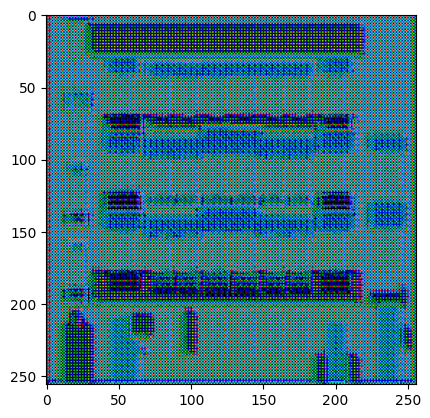

In [33]:
# Testando para uma entrada aleatória com o formato [1, 256, 256, 3]
test_input = np.random.random((1, 256, 256, 3)).astype(np.float32)
test_output = generator(test_input)

print(f"Shape da entrada: {test_input.shape}")
print(f"Shape da saída: {test_output.shape}")

# Testando com a imagem padrão de testes que definimos
gen_output = generator(INPUT_IMG[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

## Definindo o Descriminador

O discriminador no pix2pix cGAN é um classificador PatchGAN convolucional — ele tenta classificar se cada patch da imagem é real ou não, como descrito no artigo do pix2pix.

 - Cada bloco no discriminador é: Convolução ->Batch normalization -> Leaky ReLU.
 - A forma da saída após a última camada é (batch_size, 30, 30, 1).
 - Cada patch de imagem 30 x 30 da saída classifica uma porção 70 x 70 da imagem de entrada.

O discriminador recebe 2 entradas:
 - A imagem de entrada e a imagem alvo, que ele deve classificar como real.
 - A imagem de entrada e a imagem gerada (a saída do gerador), que ele deve classificar como falsa.
 

In [47]:
def block(filters, size, apply_batchnorm=True):
    """
    Função que cria um bloco de camadas para a rede discriminadora.

    Parâmetros:
    filters (int): Número de filtros na camada de convolução.
    size (int): Tamanho do kernel da camada de convolução.
    apply_batchnorm (bool): Se True, aplica a normalização em lote após a camada de convolução. Padrão é True.

    Retorna:
    tf.keras.Sequential: Um bloco sequencial contendo uma camada de convolução, 
                         opcionalmente uma camada de normalização em lote, e uma camada LeakyReLU.
    """
    
    # Inicializador dos pesos da camada convolucional com distribuição normal e desvio padrão 0.02
    init = RandomNormal(stddev=0.02)
    
    # Criação de um modelo sequencial para adicionar camadas
    res = Sequential()
    
    # Adiciona uma camada de convolução 2D com os filtros, tamanho do kernel, 
    # stride de 2 e padding 'same' para manter as dimensões de saída
    res.add(Conv2D(filters, (size, size), strides=(2, 2), padding='same', kernel_initializer=init))
    
    # Se apply_batchnorm for True, adiciona uma camada de normalização em lote
    if apply_batchnorm:
        res.add(BatchNormalization())
    
    # Adiciona uma camada de ativação LeakyReLU com um coeficiente negativo de 0.2
    res.add(LeakyReLU(negative_slope=0.2))
    
    # Retorna o modelo sequencial criado
    return res

def Discriminator(img_shape):
    """
    Função que cria o modelo discriminador para uma rede adversarial generativa (GAN).

    Parâmetros:
    img_shape (tuple): Dimensões da imagem de entrada (altura, largura, canais).

    Retorna:
    tf.keras.Model: O modelo discriminador compilado.
    """
    
    # Inicializador conforme o paper com distribuição normal e desvio padrão 0.02
    init = RandomNormal(stddev=0.02)
    
    # Entrada de imagem de origem
    in_src_img = Input(shape=img_shape, name='input_image')
    # Entrada de imagem alvo
    in_target_img = Input(shape=img_shape, name='target_image')
    
    # Combinação das duas imagens
    merged_img = Concatenate()([in_src_img, in_target_img])
    
    # Aplicação dos blocos de downsampling com diferentes números de filtros
    layer = block(64, 4, False)(merged_img) # C64
    layer = block(128, 4)(layer) # C128
    layer = block(256, 4)(layer) # C256
    
    # Adiciona uma camada de padding com zeros
    pad1 = ZeroPadding2D()(layer)
    
    # Segunda última camada de saída
    layer = Conv2D(512, (4, 4), strides=1, kernel_initializer=init)(pad1)
    layer = BatchNormalization()(layer)
    layer = LeakyReLU(negative_slope=0.2)(layer)
    
    # Adiciona uma camada de padding com zeros
    pad2 = ZeroPadding2D()(layer)
    
    # Camada de saída do patch
    layer = Conv2D(1, (4, 4), padding='same', kernel_initializer=init)(pad2)
    
    # Define o modelo com as imagens de entrada e a camada de saída
    model = Model([in_src_img, in_target_img], layer)
    # Compila o modelo com função de perda e otimizador
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    
    return model

# Exemplo de uso
img_shape = (256, 256, 3)
discriminator = Discriminator(img_shape)
discriminator.summary()

# SE QUISER PLOTAR O MODELO:
# tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)


Model: "functional_75"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_image         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ target_image        │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_31      │ (None, 256, 256,  │          0 │ input_image[0][0… │
│ (Concatenate)       │ 6)                │            │ target_image[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_66       │ (None, 128, 128,  │      6,208 │ concatenate_31[0… │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_67       │ (None, 64, 64,    │    131,712 │ sequential_66[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_68       │ (None, 32, 32,    │    525,568 │ sequential_67[0]… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_4    │ (None, 34, 34,    │          0 │ sequential_68[0]… │
│ (ZeroPadding2D)     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_49 (Conv2D)  │ (None, 31, 31,    │  2,097,664 │ zero_padding2d_4… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 31, 31,    │      2,048 │ conv2d_49[0][0]   │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_43      │ (None, 31, 31,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_5    │ (None, 33, 33,    │          0 │ leaky_re_lu_43[0… │
│ (ZeroPadding2D)     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_50 (Conv2D)  │ (None, 33, 33, 1) │      8,193 │ zero_padding2d_5… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,771,393 (10.57 MB)

 Trainable params: 2,769,601 (10.57 MB)

 Non-trainable params: 1,792 (7.00 KB)

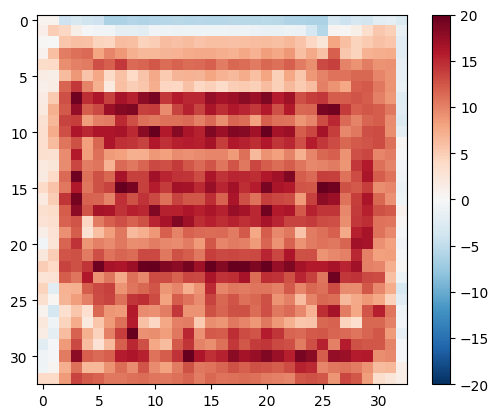

In [37]:
disc_out = discriminator([INPUT_IMG[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

## Definindo as Losses

### Loss do Gerador

GANs aprendem uma função de perda que se adapta aos dados, enquanto cGANs aprendem uma função de perda estruturada que penaliza uma possível estrutura que difere da saída da rede e da imagem alvo.

A perda do gerador é uma perda de entropia cruzada sigmoide das imagens geradas e um array de uns.

O artigo do pix2pix também utiliza MAE (erro absoluto médio) entre a imagem gerada e a imagem alvo.

Isso permite que a imagem gerada se torne estruturalmente semelhante à imagem alvo.

A fórmula para calcular a perda total do gerador é gan_loss + LAMBDA * MAE, onde LAMBDA = 100 conforme o artigo.

In [41]:
# Definindo a Loss do Gerador
# Definindo o fator de peso para a perda L1 (MAE)
LAMBDA = 100

# Inicializa a função de perda binária cross-entropy para usar na perda adversarial
loss_object = BinaryCrossentropy(from_logits=True)

def Generator_loss(disc_generated_output, gen_output, target):
    """
    Calcula a perda total do gerador, que é a soma da perda adversarial e da perda L1.

    Parâmetros:
    disc_generated_output (tensor): Saída do discriminador para a imagem gerada.
    gen_output (tensor): Imagem gerada pelo gerador.
    target (tensor): Imagem alvo real.

    Retorna:
    total_gen_loss (tensor): Perda total do gerador.
    gan_loss (tensor): Perda adversarial do gerador.
    l1_loss (tensor): Perda L1 do gerador.
    """
    
    # Calcula a perda adversarial usando a função BinaryCrossentropy
    # Aqui, compara-se a saída do discriminador com um tensor de 1s (indicando que as imagens geradas são reais)
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    
    # Calcula a perda L1 (Mean Absolute Error) entre a imagem gerada e a imagem alvo
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    
    # Calcula a perda total do gerador como a soma da perda adversarial e a perda L1 ponderada por LAMBDA
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    
    # Retorna a perda total do gerador, a perda adversarial e a perda L1
    return total_gen_loss, gan_loss, l1_loss

### Loss do Descriminador

A função discriminator_loss recebe 2 entradas: imagens reais e imagens geradas.

 - A real_loss é a perda Sigmoid Cross-entropy das imagens reais e um array de uns (imagens reais).
 - A generated_loss é a perda de Sigmoid Cross-entropy das imagens geradas e um array de zeros (imagens falsas).
 - A total_loss é a soma de real_loss e generated_loss.

In [51]:
# Definindo a Loss do Descriminador

# Inicializa a função de perda binária cross-entropy para usar na perda do discriminador
loss_object = BinaryCrossentropy(from_logits=True)

def Discriminator_loss(disc_real_output, disc_generated_output):
    """
    Calcula a perda total do discriminador, que é a soma da perda nas imagens reais e geradas.

    Parâmetros:
    disc_real_output (tensor): Saída do discriminador para a imagem real.
    disc_generated_output (tensor): Saída do discriminador para a imagem gerada.

    Retorna:
    total_disc_loss (tensor): Perda total do discriminador.
    """
    
    # Calcula a perda para as imagens reais, comparando a saída do discriminador com um tensor de 1s
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    
    # Calcula a perda para as imagens geradas, comparando a saída do discriminador com um tensor de 0s
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    
    # Calcula a perda total do discriminador como a soma das perdas nas imagens reais e geradas
    total_disc_loss = real_loss + generated_loss
    
    # Retorna a perda total do discriminador
    return total_disc_loss

In [53]:
# Definindo os otimizadores
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [57]:
def generate_images(model, test_input, tar):
    """
    Gera e exibe imagens comparando a entrada do modelo, a verdade real e a predição do modelo.

    Parâmetros:
    model (tf.keras.Model): O modelo gerador treinado.
    test_input (tensor): A imagem de entrada para o modelo.
    tar (tensor): A imagem de destino (verdade real).

    Esta função:
    1. Gera a predição do modelo para a imagem de entrada.
    2. Prepara uma figura para exibir a imagem de entrada, a verdade real e a imagem predita.
    3. Exibe essas três imagens lado a lado para comparação visual.
    """
    
    # Gera a predição do modelo para a imagem de entrada
    prediction = model(test_input, training=True)
    
    # Define o tamanho da figura para exibição
    plt.figure(figsize=(15, 15))

    # Lista de imagens para exibição: entrada, verdade real, predição
    display_list = [test_input[0], tar[0], prediction[0]]
    # Títulos para cada imagem
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    # Loop para exibir as três imagens
    for i in range(3):
        # Cria um subplot para cada imagem
        plt.subplot(1, 3, i+1)
        # Define o título para cada subplot
        plt.title(title[i])
        # Ajusta os valores dos pixels para a faixa [0, 1] para exibição
        plt.imshow(display_list[i] * 0.5 + 0.5)
        # Remove os eixos para uma visualização mais limpa
        plt.axis('off')
    
    # Exibe a figura completa com as três imagens
    plt.show()

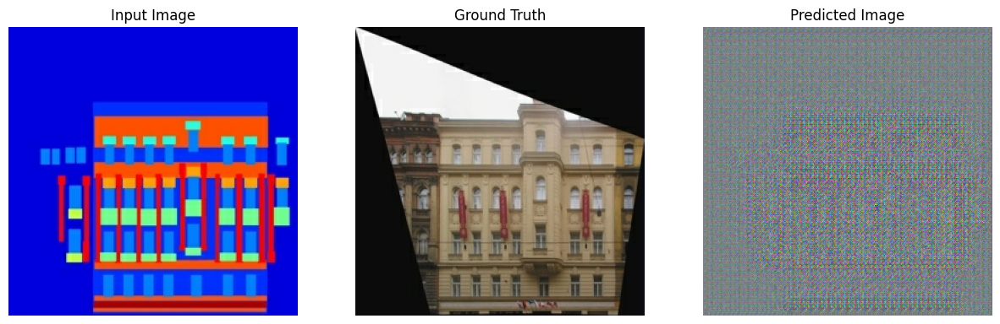

In [59]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Treinamento

Para cada exemplo de entrada, uma saída. O discriminador recebe a `input_image` e a imagem gerada como a primeira entrada. A segunda entrada é a `input_image`e a `target_image`. Em seguida, calcula a loss do gerador e do discriminador. Depois, faz o backpropagation em relação às variáveis do gerador e do discriminador (entradas) e aplica esses gradientes ao otimizador. Além disso foram criados checkpoints e logs para salvar informações do treino a medida que ele ocorresse, já que o treinamento de uma GAN não é aquele tradicional e sim depende da dinâmica entre o gerador e o discriminador, que se enfrentam em um jogo de soma zero, onde a convergência e a estabilidade são complexas e críticas. Assim, o processo de treinamento é volátil de forma que durante elem, pode haver momentos onde a GAN atinge um equilíbrio temporário ou local que gera resultados de alta qualidade, sendo portanto crucial salvar checkpoints e acompanhar as imagens geradas.

In [242]:
# Definir diretório para checkpoints e logs
checkpoint_dir = './training_checkpoints'
log_dir = './logs'

# Criar diretórios se não existirem
os.makedirs(checkpoint_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)

# Definir prefixo para checkpoints
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")

# Configurar checkpoints
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [60]:
# Função de treinamento para um passo
@tf.function
def train_step(input_image, target, step):
    """
    Executa um passo de treinamento da GAN.

    Parâmetros:
    input_image (tensor): A imagem de entrada para o gerador.
    target (tensor): A imagem de destino (verdade real).
    step (int): O passo atual de treinamento.
    """

    # Abre um contexto de gravação de gradientes para o gerador e o discriminador
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Gera a saída do gerador a partir da imagem de entrada
        gen_output = generator(input_image, training=True)

        # Obtém a saída do discriminador para as imagens reais
        disc_real_output = discriminator([input_image, target], training=True)
        # Obtém a saída do discriminador para as imagens geradas
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        # Calcula a perda do gerador
        gen_total_loss, gen_gan_loss, gen_l1_loss = Generator_loss(disc_generated_output, gen_output, target)
        # Calcula a perda do discriminador
        disc_loss = Discriminator_loss(disc_real_output, disc_generated_output)

    # Calcula os gradientes do gerador
    generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    # Calcula os gradientes do discriminador
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Aplica os gradientes calculados ao gerador
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    # Aplica os gradientes calculados ao discriminador
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    # A linha está comentada pois eram essas infos que eu salvava no log
    # return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss

# Função para salvar logs em um arquivo
# Não utilizei a princípio pois deixava o treinamento muito lento aparentemente
def save_logs(log_file, step, gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss):
    with open(log_file, 'a') as f:
        f.write(f'Step: {step}, Gen Total Loss: {gen_total_loss.numpy()}, Gen GAN Loss: {gen_gan_loss.numpy()}, Gen L1 Loss: {gen_l1_loss.numpy()}, Disc Loss: {disc_loss.numpy()}\n')

In [61]:
from tqdm import tqdm
import time

def fit(train_ds, test_ds, steps):
    example_input, example_target = next(iter(test_ds.take(1)))
    start = time.time()

    # Arquivo de log
    # log_file = os.path.join(log_dir, 'training.log')

    for step, (input_image, target) in tqdm(train_ds.repeat().take(steps).enumerate()):
        # Salvando logs a cada 1000 passos
      if (step) % 100 == 0:
          if step != 0:
              print(f'Tempo decorrido para 100 passos: {time.time() - start:.2f} segundos\n')
          start = time.time()

          # Gerar imagens para exibir progresso
          generate_images(generator, example_input, example_target)
          print(f"Passo: {step // 100}k")

          # save_logs(log_file, step, gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss)

      train_step(input_image, target, step)

      # Salvar checkpoint a cada 500 passos
      if (step + 1) % 500 == 0:
          checkpoint.save(file_prefix=checkpoint_prefix)

### Resultado do Treino:
Devido ao peso da rede e ao tempo considerável necessário para a execução, optei por não salvar checkpoints ou logs, pois isso tornava o treinamento ainda mais demorado e pesado. Meu objetivo era rodar 40.000 passos, mas não consegui nem mesmo completar 10.000. O processamento no Colab foi interrompido e o processamento local sobrecarregou meu computador. Assim, acabei rodando poucas épocas. No entanto, imprimi os resultados das imagens abaixo, onde é possível ver que o modelo começou a aprender algo, embora ainda esteja longe de atingir um ponto de equilíbrio ou ótimos resultados. Isso é ainda mais desafiador devido à dificuldade das GANs em convergir. Apesar disso, é possível notar que, ao receber o projeto arquitetônico, o modelo começou a se aproximar de uma imagem real, realizando uma certa tradução.

  0%|          | 0/40000 [00:00<?, ?it/s]

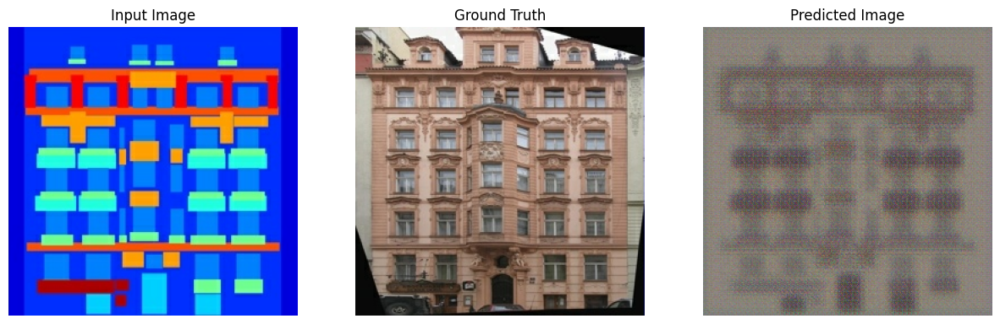

Passo: 0k


  0%|          | 100/40000 [03:04<21:25:34,  1.93s/it]

Tempo decorrido para 100 passos: 182.56 segundos



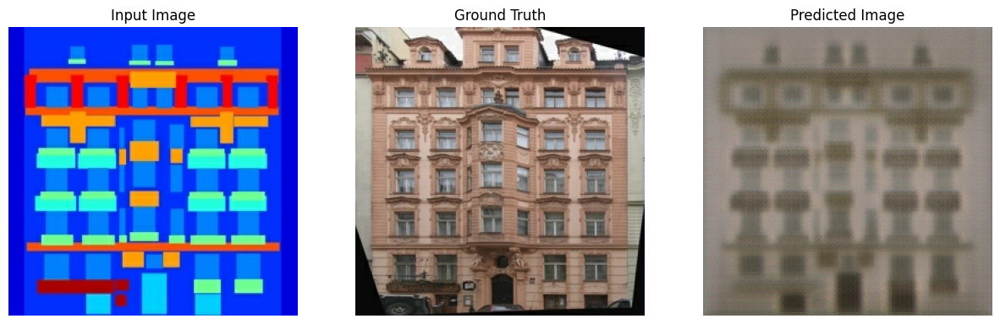

Passo: 1k


  0%|          | 200/40000 [05:21<13:55:03,  1.26s/it]

Tempo decorrido para 100 passos: 137.73 segundos



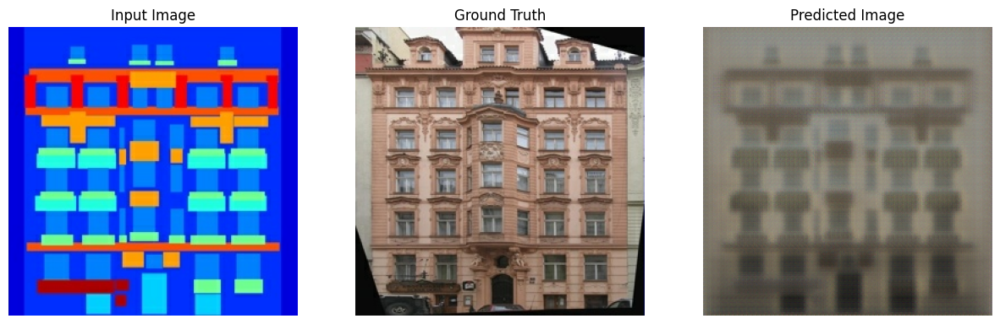

Passo: 2k


  1%|          | 300/40000 [07:31<14:27:50,  1.31s/it]

Tempo decorrido para 100 passos: 129.52 segundos



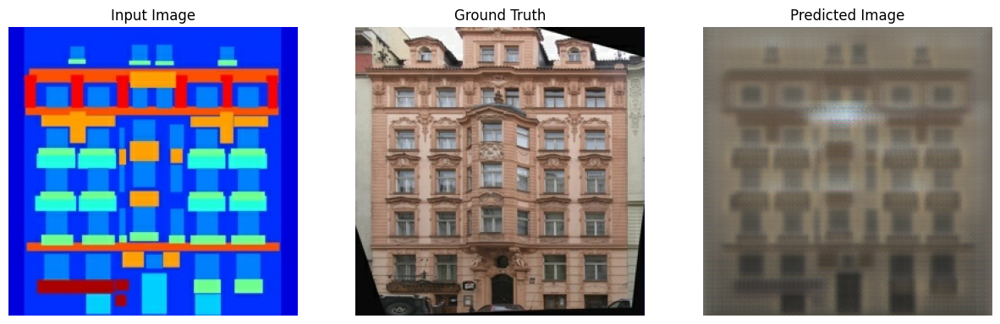

Passo: 3k


  1%|          | 400/40000 [09:41<16:01:53,  1.46s/it]

Tempo decorrido para 100 passos: 129.65 segundos



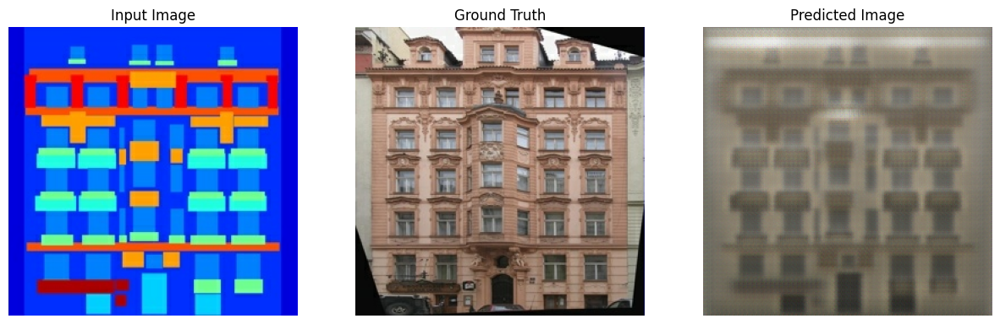

Passo: 4k


  1%|▏         | 500/40000 [11:43<13:20:48,  1.22s/it]

Tempo decorrido para 100 passos: 122.83 segundos



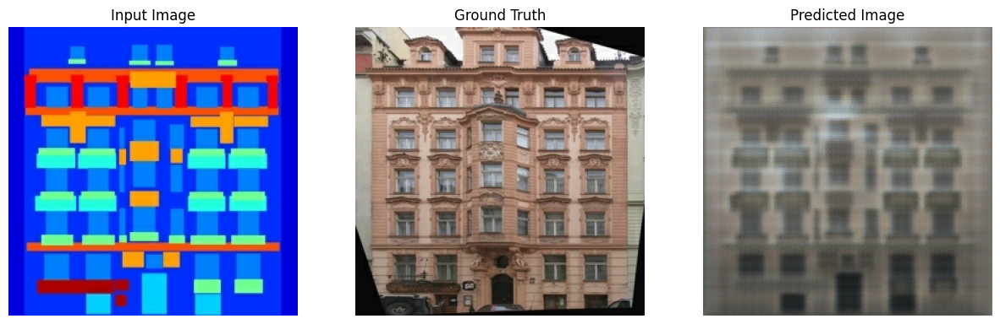

Passo: 5k


  2%|▏         | 600/40000 [13:47<15:26:46,  1.41s/it]

Tempo decorrido para 100 passos: 123.03 segundos



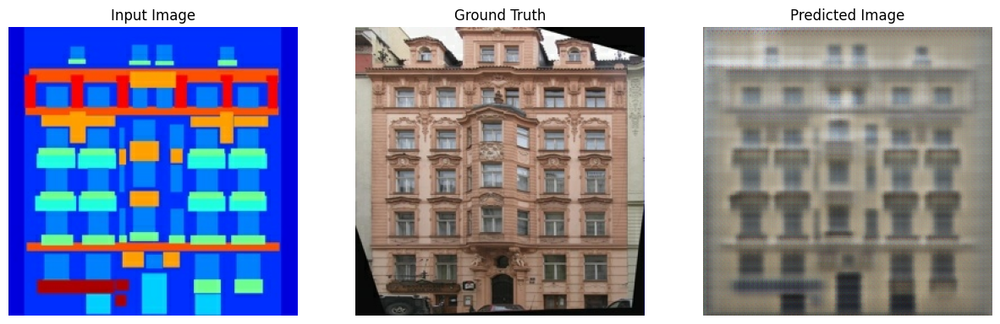

Passo: 6k


  2%|▏         | 700/40000 [16:25<17:14:20,  1.58s/it]

Tempo decorrido para 100 passos: 158.83 segundos



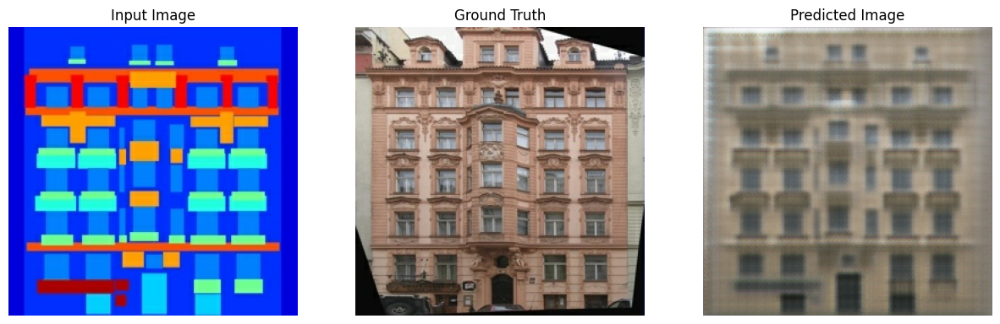

Passo: 7k


  2%|▏         | 800/40000 [19:02<19:53:19,  1.83s/it]

Tempo decorrido para 100 passos: 157.14 segundos



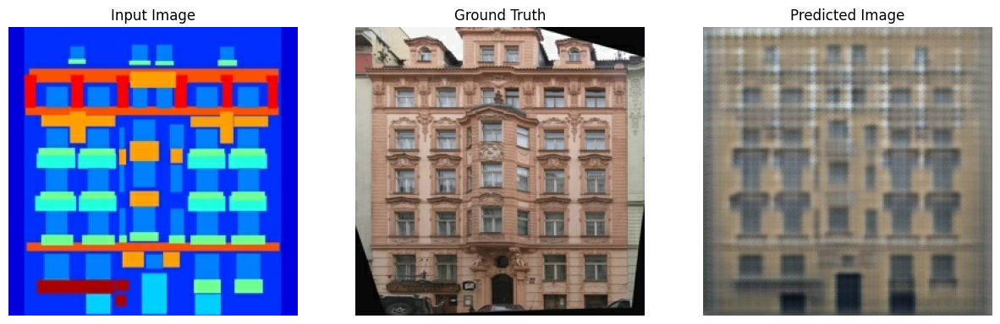

Passo: 8k


  2%|▏         | 900/40000 [21:57<20:56:16,  1.93s/it]

Tempo decorrido para 100 passos: 174.12 segundos



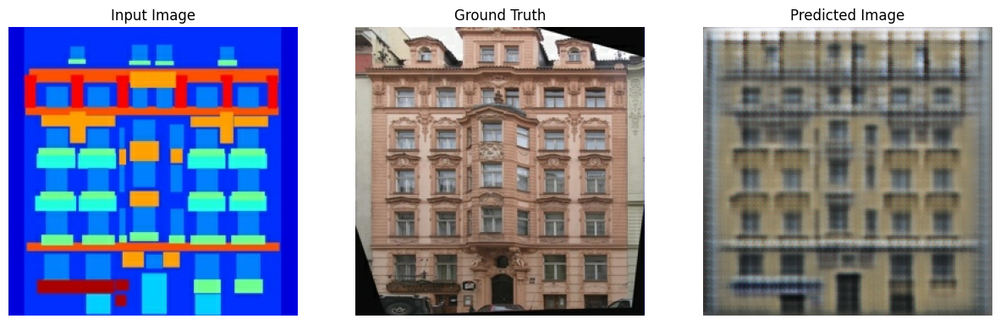

Passo: 9k


  2%|▎         | 1000/40000 [25:11<20:56:00,  1.93s/it]

Tempo decorrido para 100 passos: 194.30 segundos



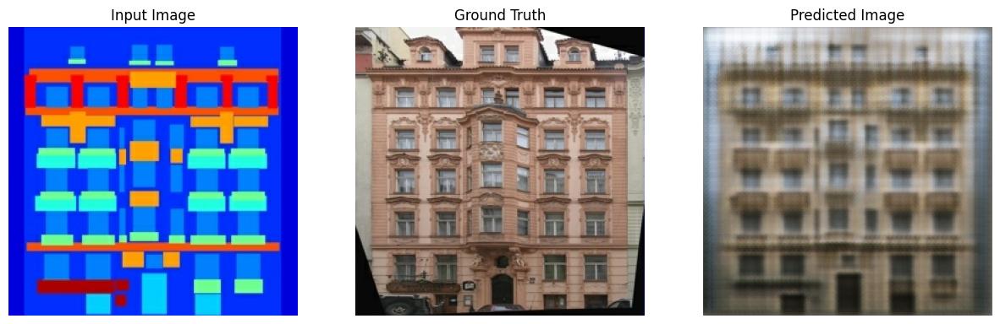

Passo: 10k


  3%|▎         | 1100/40000 [28:24<20:55:59,  1.94s/it]

Tempo decorrido para 100 passos: 193.54 segundos



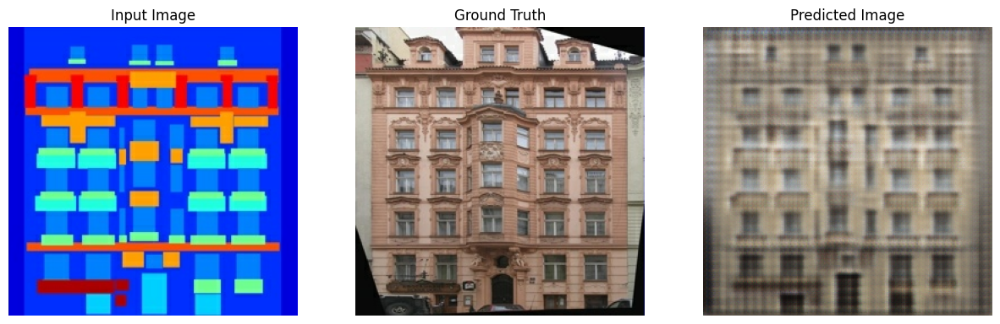

Passo: 11k


  3%|▎         | 1200/40000 [31:23<19:32:59,  1.81s/it]

Tempo decorrido para 100 passos: 178.85 segundos



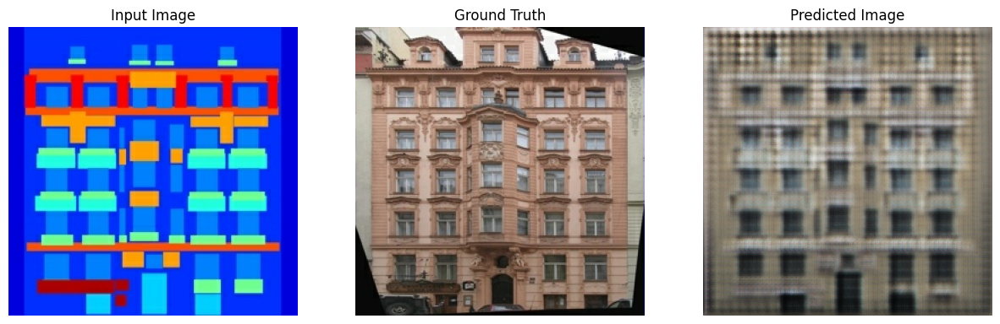

Passo: 12k


  3%|▎         | 1300/40000 [33:54<16:05:25,  1.50s/it]

Tempo decorrido para 100 passos: 150.28 segundos



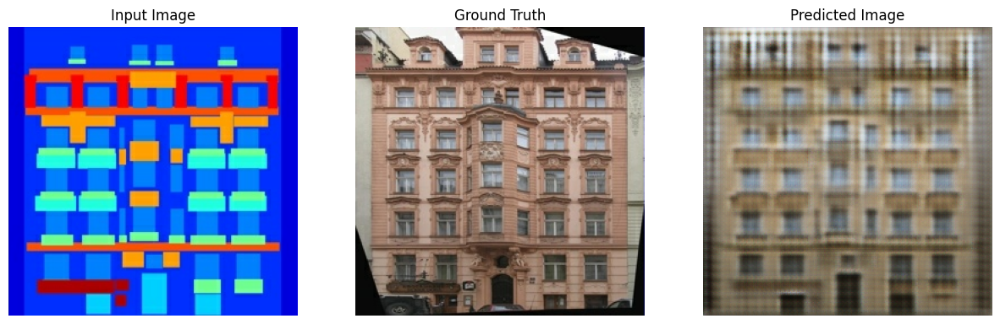

Passo: 13k


  4%|▎         | 1400/40000 [36:22<15:21:20,  1.43s/it]

Tempo decorrido para 100 passos: 148.43 segundos



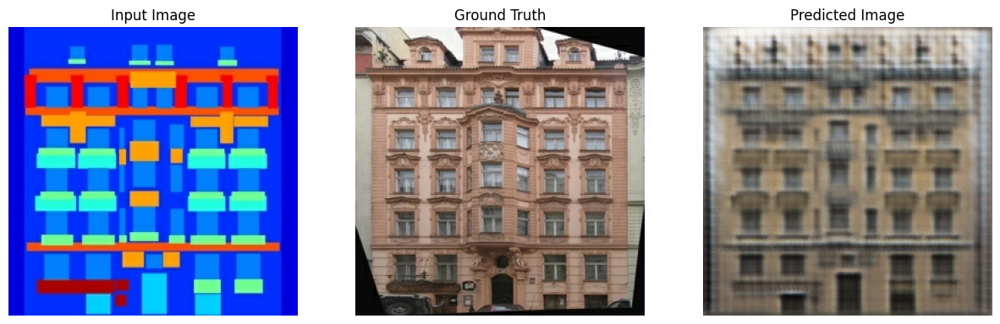

Passo: 14k


  4%|▍         | 1500/40000 [38:57<15:41:33,  1.47s/it]

Tempo decorrido para 100 passos: 155.13 segundos



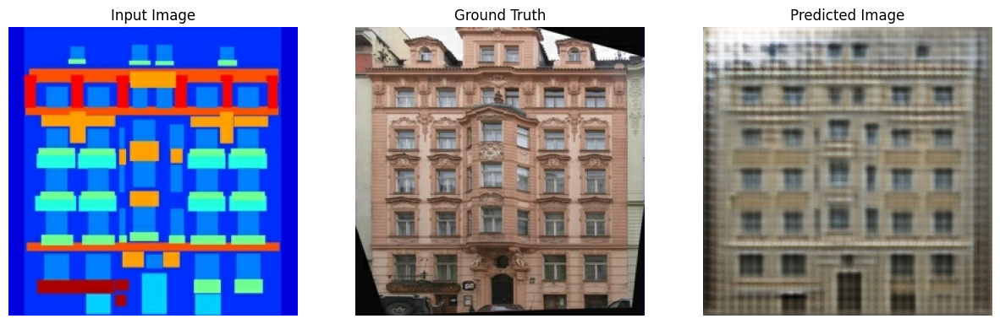

Passo: 15k


  4%|▍         | 1600/40000 [41:13<16:38:10,  1.56s/it]

Tempo decorrido para 100 passos: 135.62 segundos



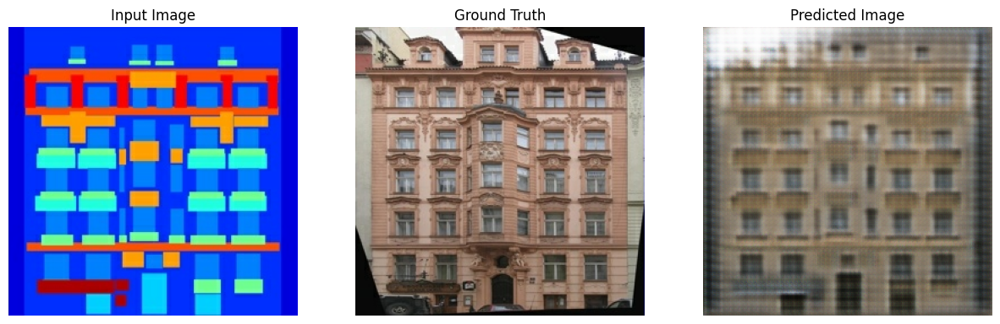

Passo: 16k


  4%|▍         | 1700/40000 [43:27<14:22:15,  1.35s/it]

Tempo decorrido para 100 passos: 134.37 segundos



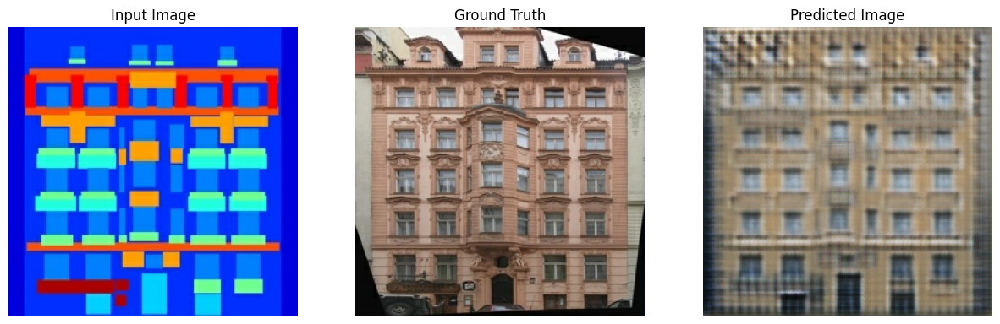

Passo: 17k


  4%|▍         | 1800/40000 [45:42<14:10:08,  1.34s/it]

Tempo decorrido para 100 passos: 135.16 segundos



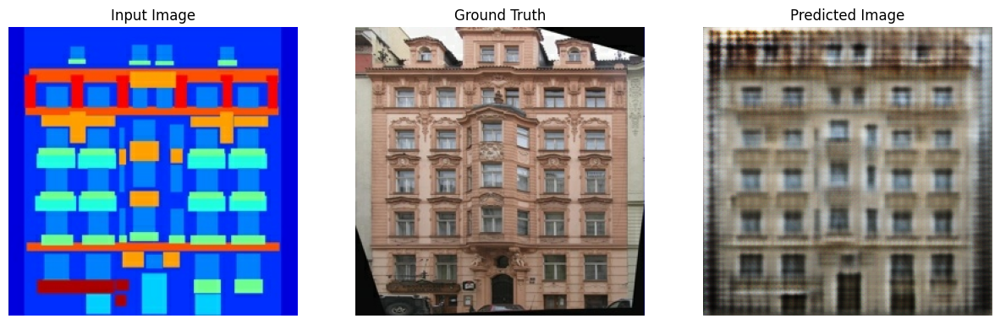

Passo: 18k


  5%|▍         | 1900/40000 [47:57<13:51:25,  1.31s/it]

Tempo decorrido para 100 passos: 134.33 segundos



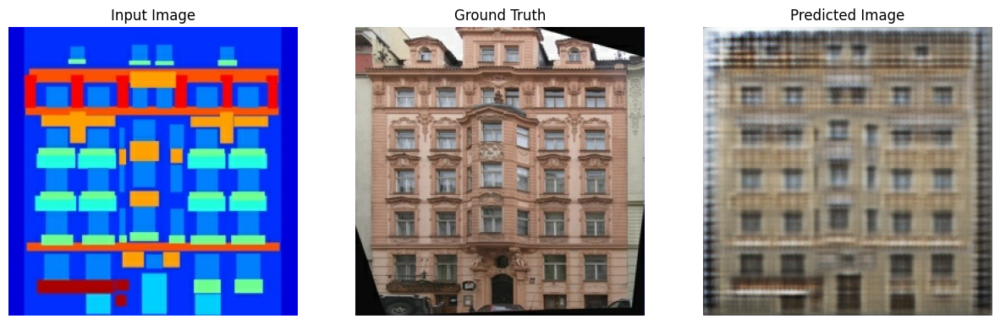

Passo: 19k


  5%|▌         | 2000/40000 [50:12<16:30:58,  1.56s/it]

Tempo decorrido para 100 passos: 135.06 segundos



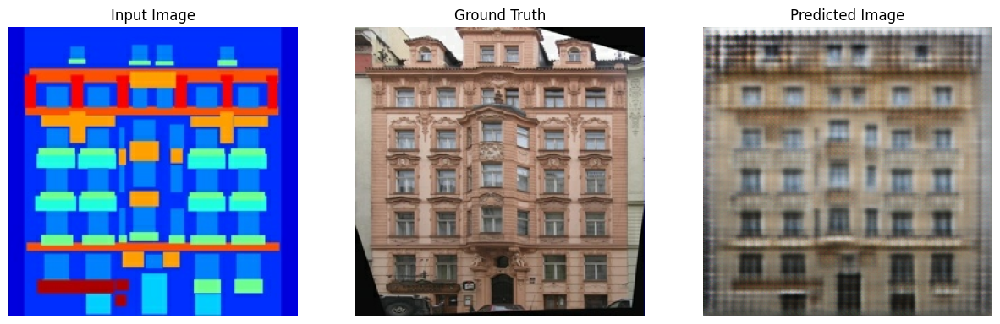

Passo: 20k


  5%|▌         | 2100/40000 [52:26<14:14:46,  1.35s/it]

Tempo decorrido para 100 passos: 134.25 segundos



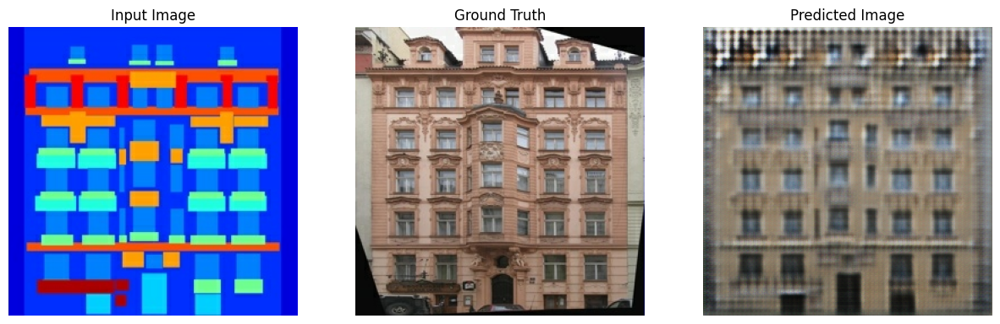

Passo: 21k


  6%|▌         | 2200/40000 [54:40<13:54:02,  1.32s/it]

Tempo decorrido para 100 passos: 134.11 segundos



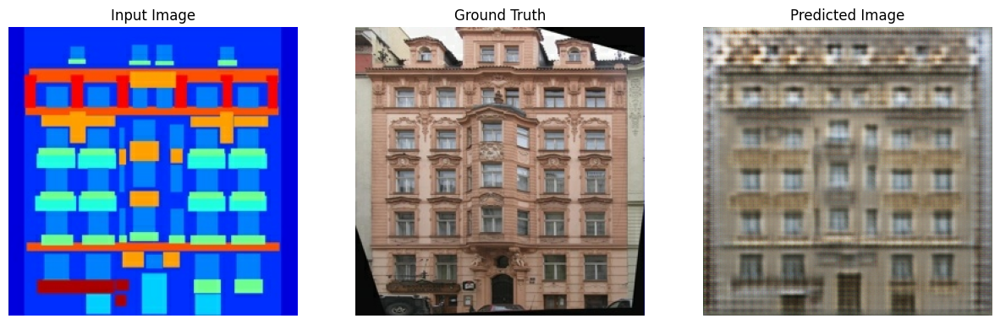

Passo: 22k


  6%|▌         | 2300/40000 [56:54<14:01:35,  1.34s/it]

Tempo decorrido para 100 passos: 133.70 segundos



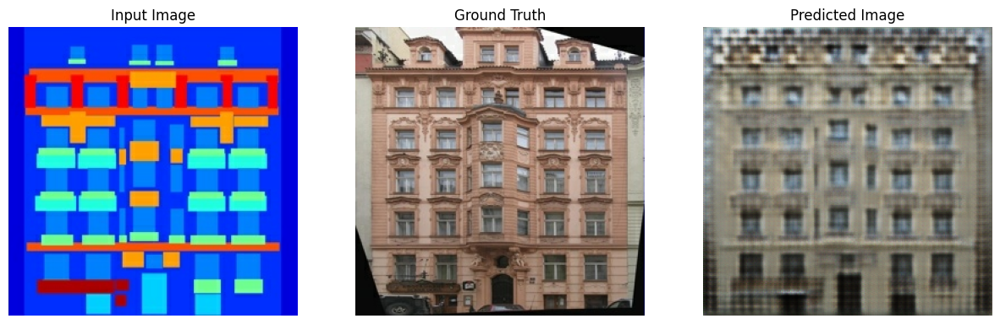

Passo: 23k


  6%|▌         | 2400/40000 [59:09<16:21:22,  1.57s/it]

Tempo decorrido para 100 passos: 134.75 segundos



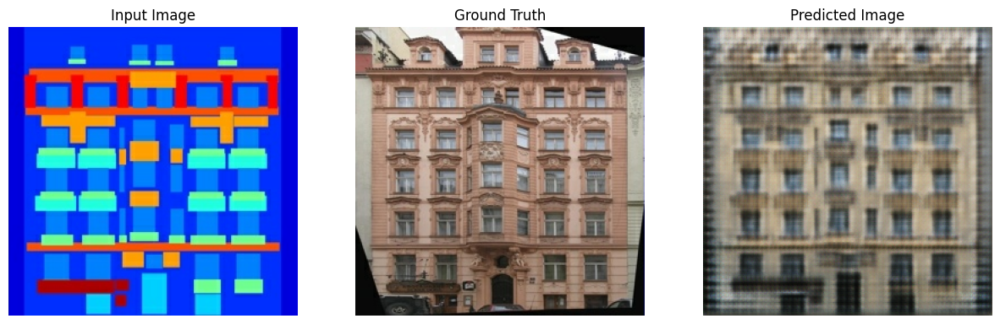

Passo: 24k


  6%|▋         | 2500/40000 [1:01:25<13:38:42,  1.31s/it]

Tempo decorrido para 100 passos: 136.94 segundos



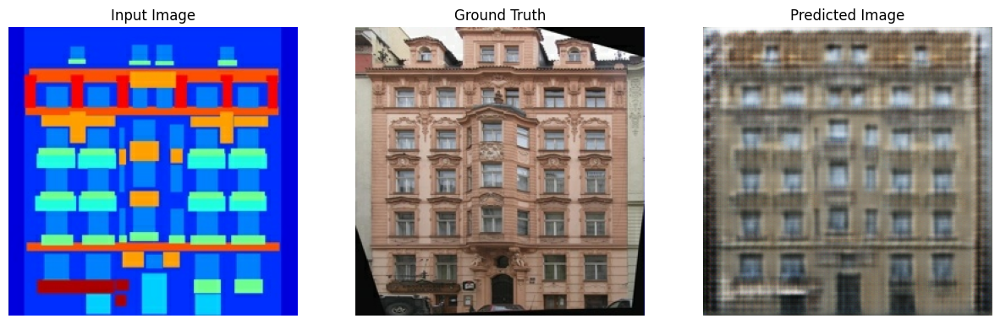

Passo: 25k


  6%|▋         | 2600/40000 [1:03:40<13:53:38,  1.34s/it]

Tempo decorrido para 100 passos: 134.11 segundos



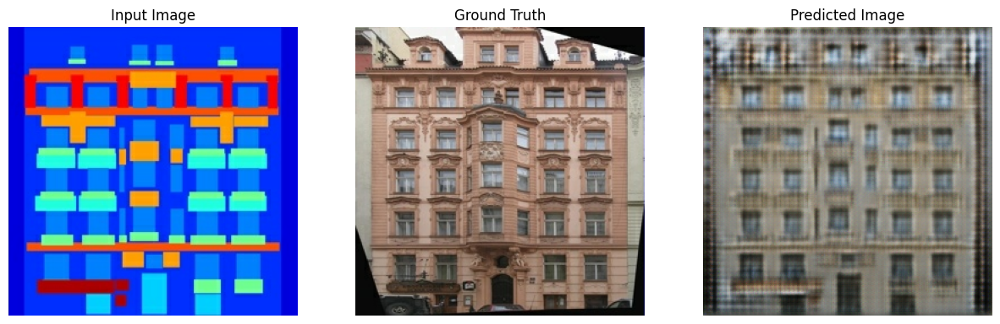

Passo: 26k


  7%|▋         | 2700/40000 [1:05:53<13:54:05,  1.34s/it]

Tempo decorrido para 100 passos: 133.81 segundos



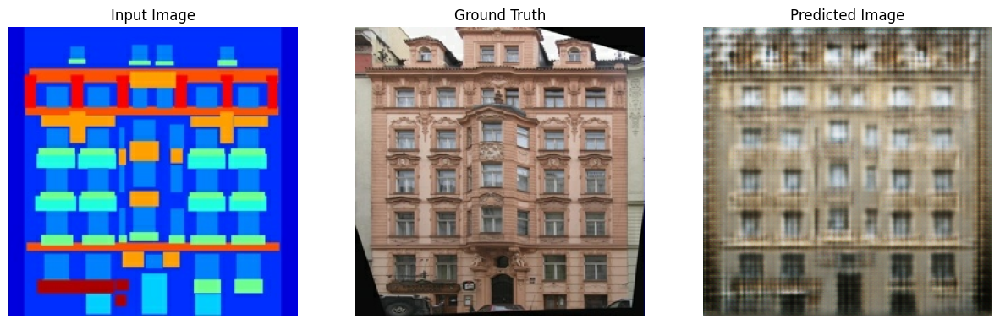

Passo: 27k


  7%|▋         | 2800/40000 [1:08:08<16:05:10,  1.56s/it]

Tempo decorrido para 100 passos: 134.63 segundos



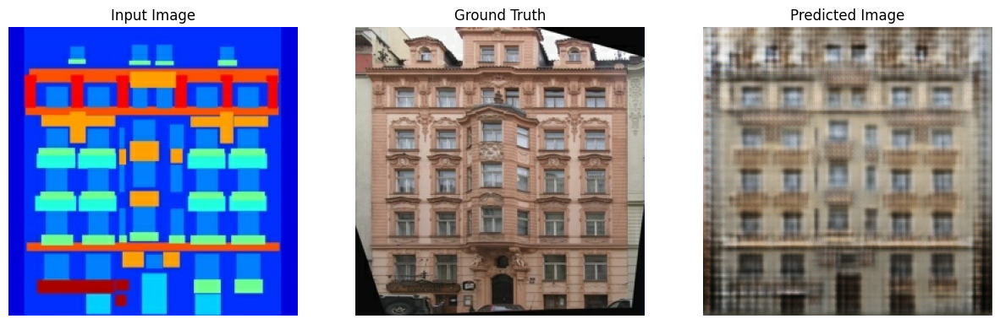

Passo: 28k


  7%|▋         | 2900/40000 [1:10:23<13:35:03,  1.32s/it]

Tempo decorrido para 100 passos: 134.50 segundos



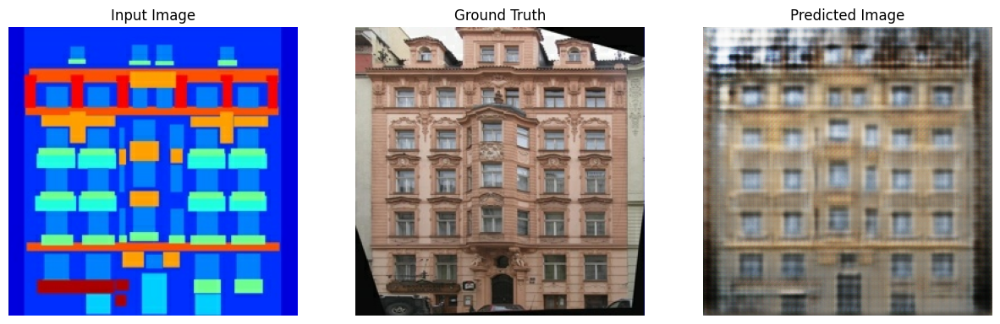

Passo: 29k


  8%|▊         | 3000/40000 [1:12:36<13:28:42,  1.31s/it]

Tempo decorrido para 100 passos: 133.85 segundos



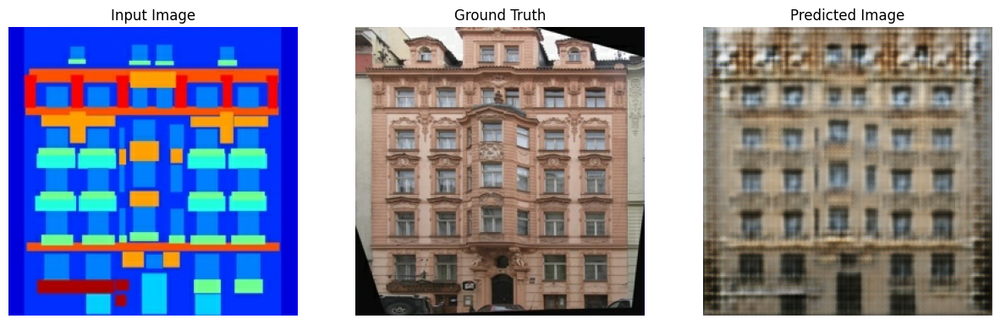

Passo: 30k


  8%|▊         | 3100/40000 [1:14:50<13:48:27,  1.35s/it]

Tempo decorrido para 100 passos: 133.31 segundos



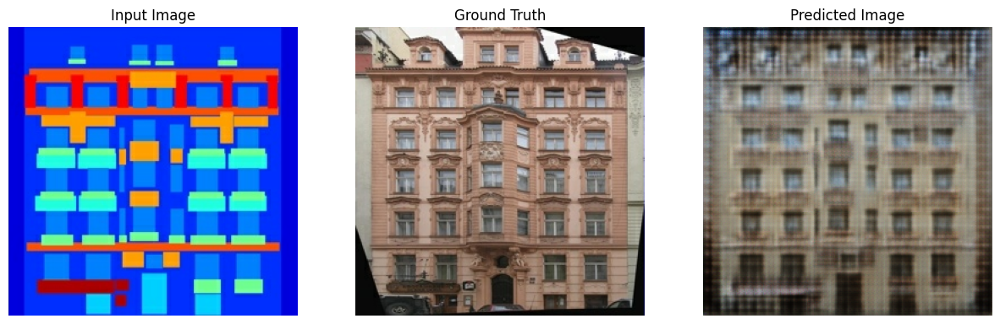

Passo: 31k


  8%|▊         | 3200/40000 [1:17:04<15:43:13,  1.54s/it]

Tempo decorrido para 100 passos: 134.25 segundos



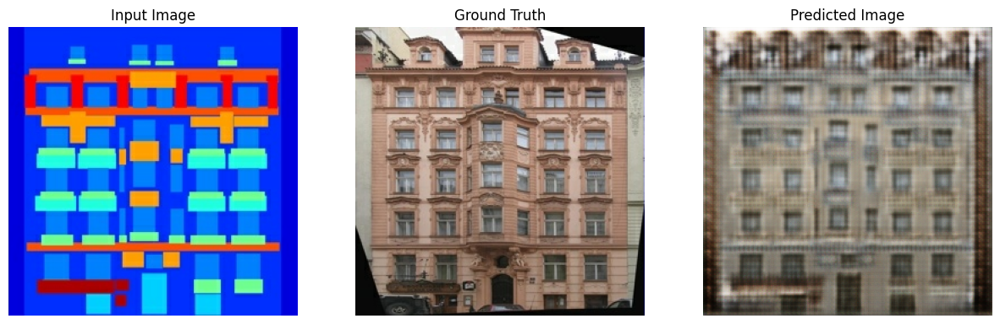

Passo: 32k


  8%|▊         | 3300/40000 [1:19:18<13:29:27,  1.32s/it]

Tempo decorrido para 100 passos: 133.78 segundos



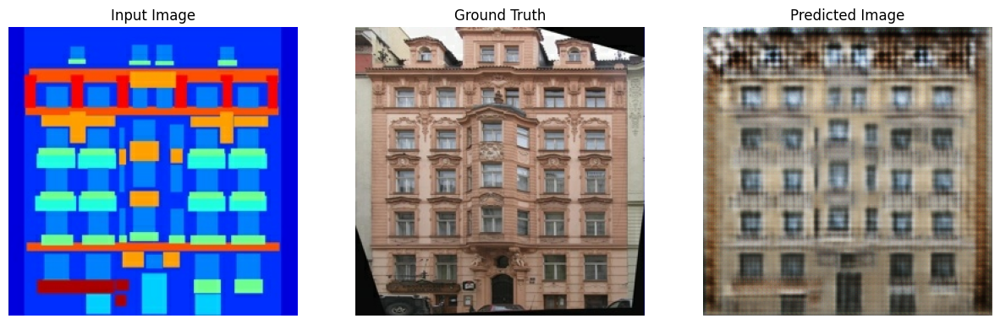

Passo: 33k


  8%|▊         | 3400/40000 [1:21:31<13:21:33,  1.31s/it]

Tempo decorrido para 100 passos: 133.62 segundos



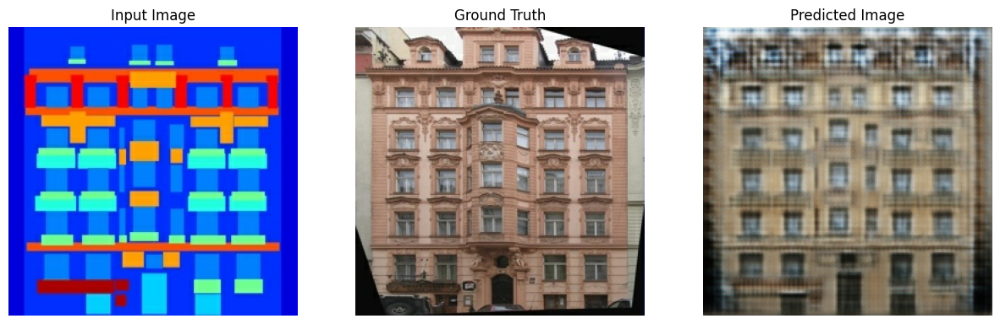

Passo: 34k


  9%|▉         | 3500/40000 [1:23:45<13:41:59,  1.35s/it]

Tempo decorrido para 100 passos: 133.31 segundos



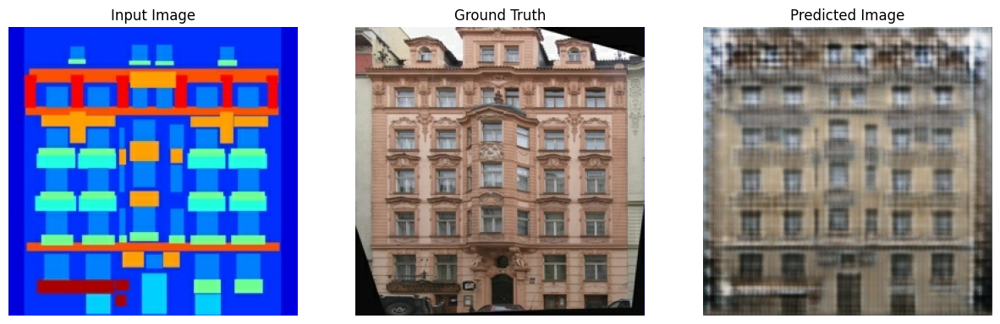

Passo: 35k


  9%|▉         | 3600/40000 [1:25:59<16:03:19,  1.59s/it]

Tempo decorrido para 100 passos: 134.21 segundos



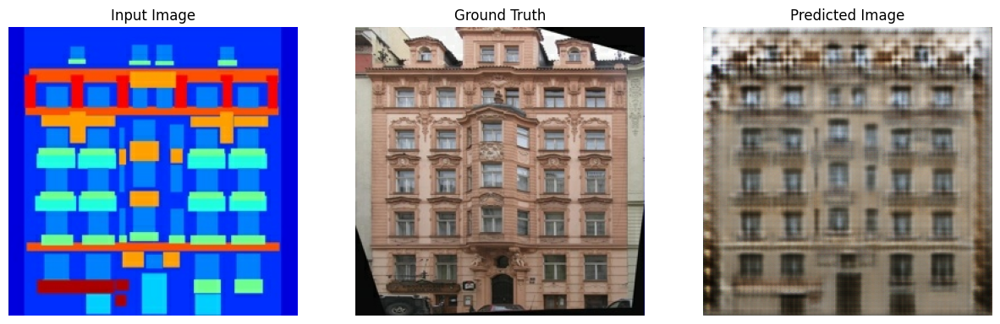

Passo: 36k


  9%|▉         | 3700/40000 [1:28:13<13:12:26,  1.31s/it]

Tempo decorrido para 100 passos: 133.98 segundos



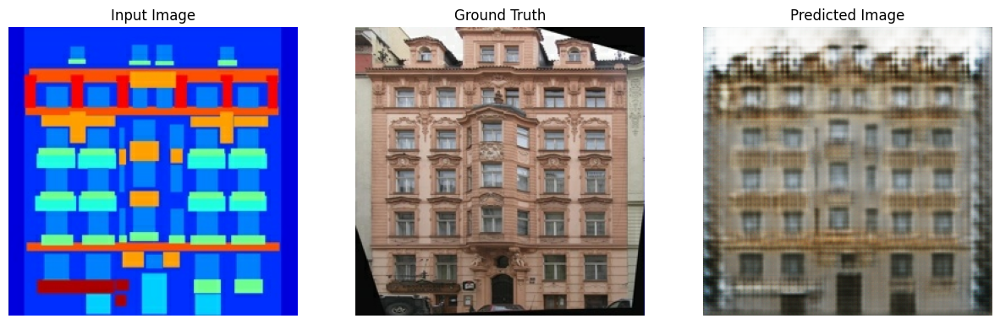

Passo: 37k


 10%|▉         | 3800/40000 [1:30:23<10:58:06,  1.09s/it]

Tempo decorrido para 100 passos: 130.46 segundos



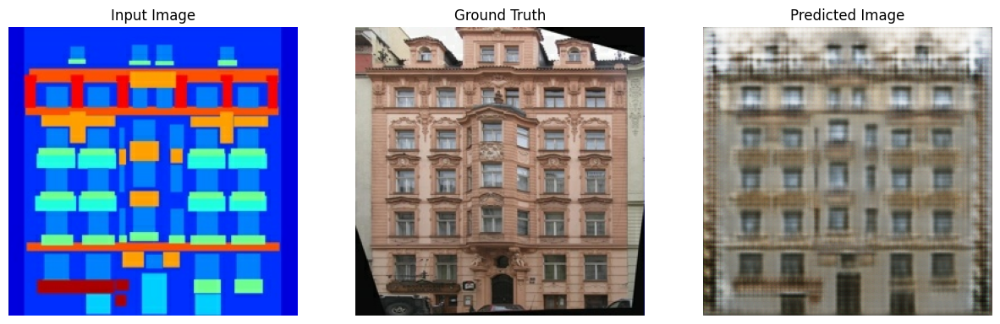

Passo: 38k


 10%|▉         | 3900/40000 [1:32:18<12:33:15,  1.25s/it]

Tempo decorrido para 100 passos: 114.81 segundos



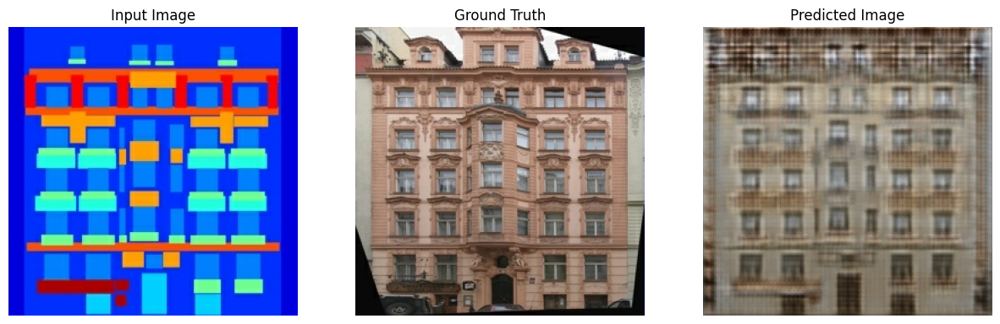

Passo: 39k


 10%|█         | 4000/40000 [1:34:27<17:16:41,  1.73s/it]

Tempo decorrido para 100 passos: 128.39 segundos



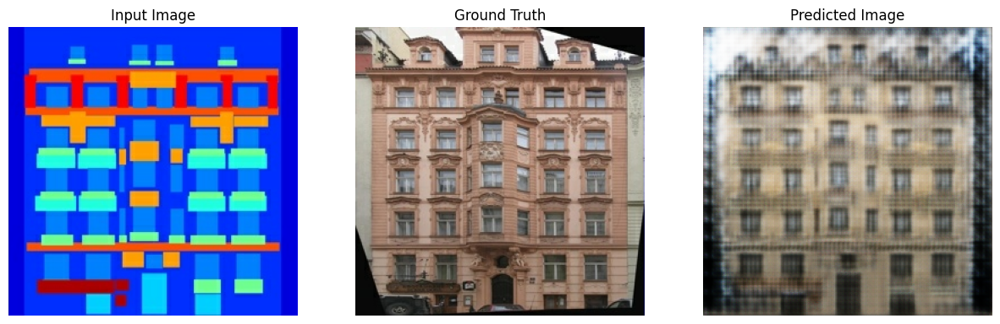

Passo: 40k


 10%|█         | 4100/40000 [1:36:22<11:08:03,  1.12s/it]

Tempo decorrido para 100 passos: 115.28 segundos



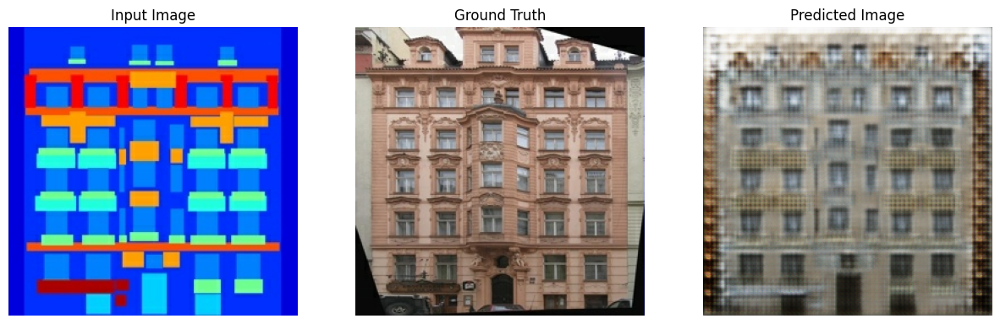

Passo: 41k


 10%|█         | 4200/40000 [1:38:17<10:51:49,  1.09s/it]

Tempo decorrido para 100 passos: 115.12 segundos



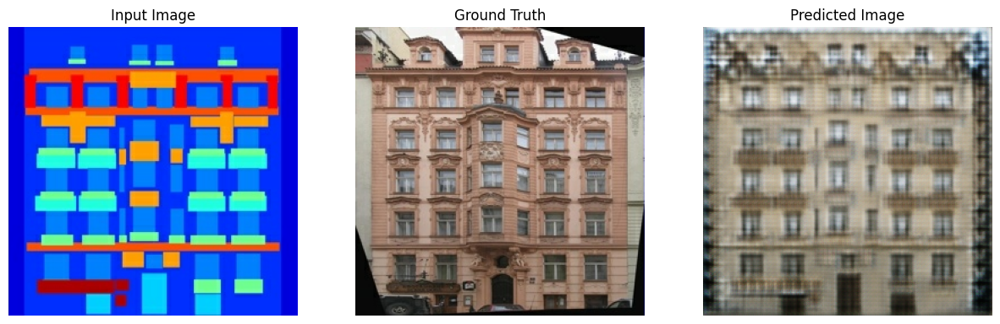

Passo: 42k


 11%|█         | 4300/40000 [1:40:10<11:03:46,  1.12s/it]

Tempo decorrido para 100 passos: 113.03 segundos



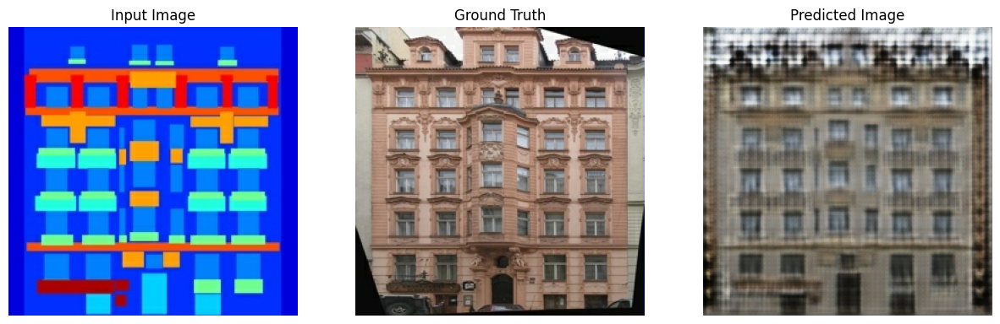

Passo: 43k


 11%|█         | 4400/40000 [1:42:03<13:05:45,  1.32s/it]

Tempo decorrido para 100 passos: 112.88 segundos



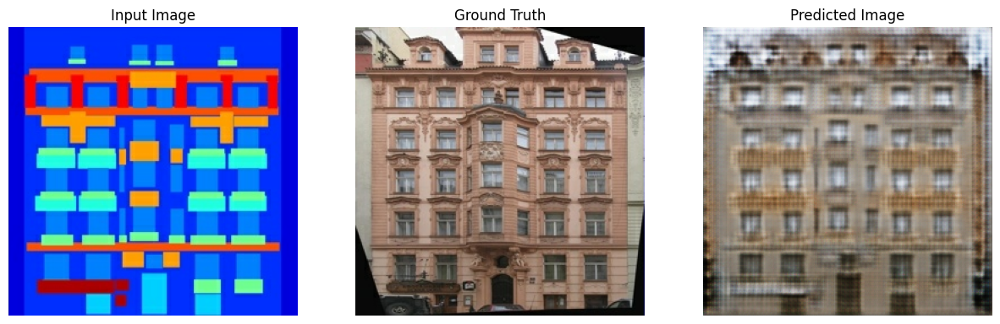

Passo: 44k


 11%|█▏        | 4500/40000 [1:43:55<11:19:13,  1.15s/it]

Tempo decorrido para 100 passos: 112.38 segundos



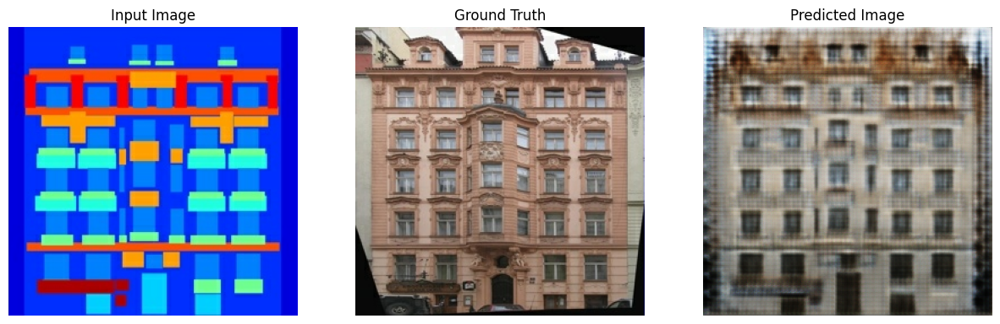

Passo: 45k


 12%|█▏        | 4600/40000 [1:46:10<18:12:01,  1.85s/it]

Tempo decorrido para 100 passos: 135.02 segundos



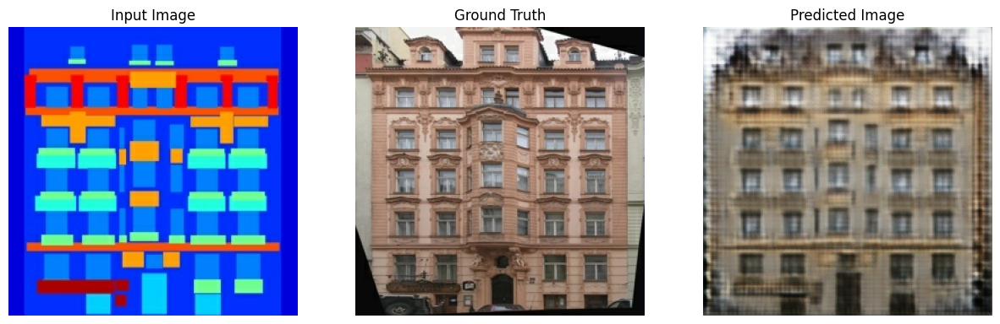

Passo: 46k


 12%|█▏        | 4676/40000 [1:48:03<13:36:17,  1.39s/it]


KeyboardInterrupt: 

In [247]:
fit(train_dataset, test_dataset, steps=40000)